In [58]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt
print("hello")

hello


In [59]:
temp=['AAPL','AMZN','GOOG','MSFT','TSLA']
start_date='2015-08-09'
end_date='2025-08-09'
df=yf.download('AAPL',start_date,end_date,threads=True,progress=True)[["Close"]]

/var/folders/y7/hf6140q96774323j7d756khw0000gn/T/ipykernel_7613/2252889455.py:4: FutureWarning:

YF.download() has changed argument auto_adjust default to True

[*********************100%***********************]  1 of 1 completed


In [60]:
df=df.stack().reset_index()
df['MA_10']=df['Close'].rolling(10).mean()
df['MA_30']=df['Close'].rolling(30).mean()

df['Signal']=np.where((df['Close']>df['MA_10'])&(df['Close']>df['MA_30']),1,0)
df['Returns']=(df['Close'].pct_change())
df['Strategy Returns']=df['Returns']*df['Signal'].shift(1)
df.dropna(inplace=True)
df

/var/folders/y7/hf6140q96774323j7d756khw0000gn/T/ipykernel_7613/316862407.py:1: FutureWarning:

The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.



Price,Date,Ticker,Close,MA_10,MA_30,Signal,Returns,Strategy Returns
29,2015-09-21,AAPL,25.890633,25.614670,25.331664,1,0.015513,0.000000
30,2015-09-22,AAPL,25.483883,25.639166,25.284322,0,-0.015710,-0.015710
31,2015-09-23,AAPL,25.690624,25.732877,25.290540,0,0.008113,0.000000
32,2015-09-24,AAPL,25.843447,25.787486,25.288742,1,0.005949,0.000000
33,2015-09-25,AAPL,25.778269,25.798722,25.285446,0,-0.002522,-0.002522
...,...,...,...,...,...,...,...,...
2510,2025-08-04,AAPL,203.119492,210.147505,208.580615,0,0.004793,0.000000
2511,2025-08-05,AAPL,202.689957,209.000806,208.627894,0,-0.002115,-0.000000
2512,2025-08-06,AAPL,213.008255,208.910909,209.059071,1,0.050907,0.000000
2513,2025-08-07,AAPL,219.780563,209.537198,209.674040,1,0.031794,0.031794


<Axes: xlabel='Date'>

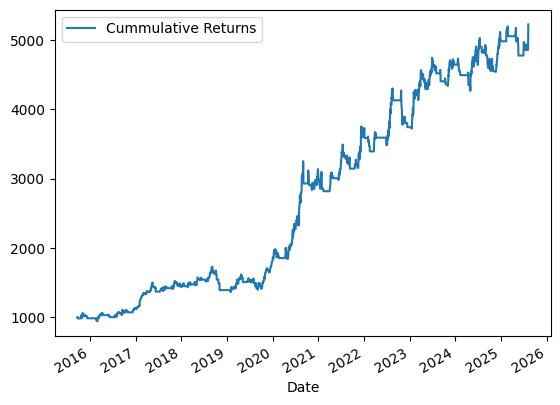

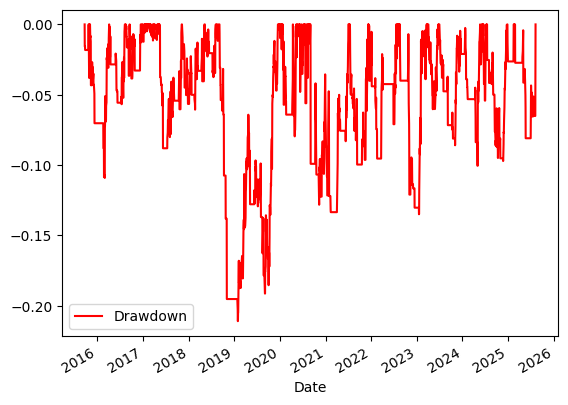

In [61]:
initial=1000
df['Cummulative Returns']=(df['Strategy Returns']+1).cumprod()*initial
df['Cummulative_max']=df['Cummulative Returns'].cummax()
df.plot(x='Date',y='Cummulative Returns',kind='line')
df['Drawdown']=(df['Cummulative Returns']/df['Cummulative_max'].cummax())-1
df.plot(x='Date',y='Drawdown',kind='line',color='red')


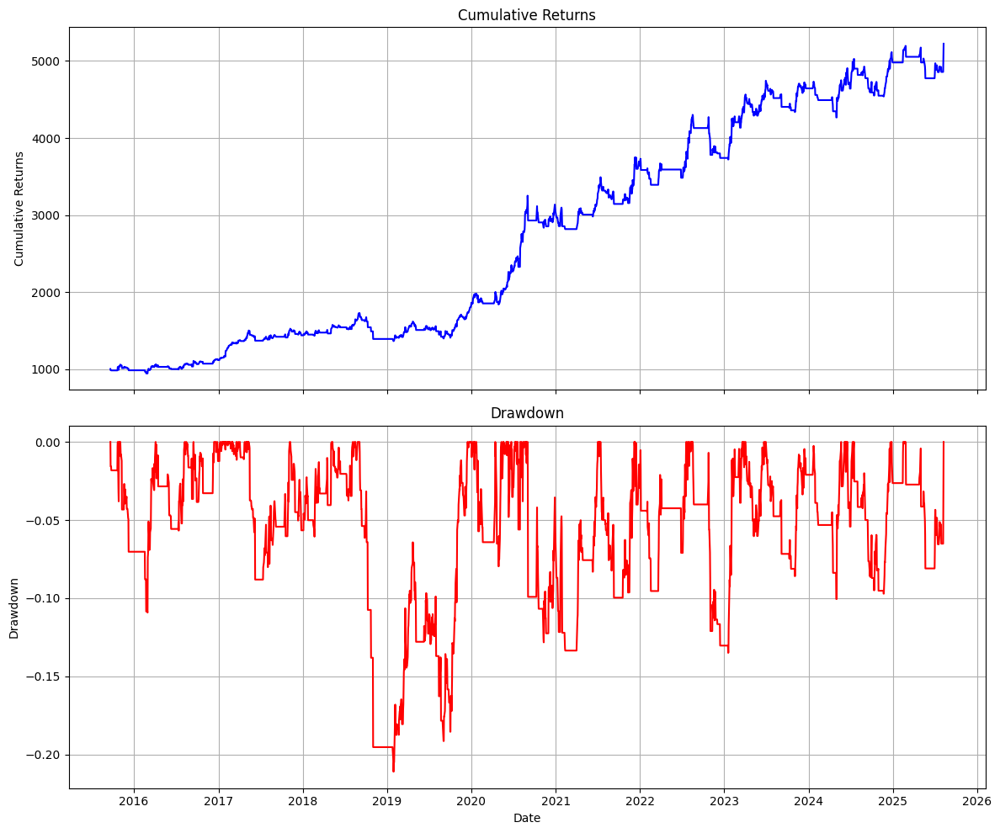

In [62]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10), sharex=True)

# Top plot: Cumulative Returns
ax1.plot(df['Date'], df['Cummulative Returns'], color='blue')
ax1.set_ylabel('Cumulative Returns')
ax1.set_title('Cumulative Returns')
ax1.grid(True)

# Bottom plot: Drawdown
ax2.plot(df['Date'], df['Drawdown'], color='red')
ax2.set_ylabel('Drawdown')
ax2.set_xlabel('Date')
ax2.set_title('Drawdown')
ax2.grid(True)

plt.tight_layout()
plt.show()


In [63]:
df['Strategy Returns'].describe()
# Calculate the daily standard deviation of the strategy's returns
daily_volatility = df['Strategy Returns'].std()

# Annualize the volatility
annualized_volatility = daily_volatility * np.sqrt(252)

print(f"Annualized Volatility: {annualized_volatility:.2%}")
# --- Step 1: Calculate Annualized Volatility (from above) ---
annualized_volatility = df['Strategy Returns'].std() * np.sqrt(252)


# --- Step 2: Calculate Annualized Return ---
# Get the mean daily return
mean_daily_return = df['Strategy Returns'].mean()

# Annualize the return
annualized_return = mean_daily_return * 252


# --- Step 3: Calculate Sharpe Ratio ---
# Set the risk-free rate (e.g., return on a U.S. Treasury bill). It's often set to 0 for simplicity.
risk_free_rate = 0.0

# Calculate the Sharpe Ratio
if annualized_volatility != 0:
    sharpe_ratio = (annualized_return - risk_free_rate) / annualized_volatility
else:
    sharpe_ratio = 0

print(f"Annualized Return: {annualized_return:.2%}")
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")


Annualized Volatility: 16.02%
Annualized Return: 18.04%
Sharpe Ratio: 1.13


In [64]:
def run_backtest(price_series,initial_capital=1000):
    df_bt=pd.DataFrame()
    df_bt['Close']=price_series
    df_bt['MA_10']=df_bt['Close'].rolling(10).mean()
    df_bt['MA_30']=df_bt['Close'].rolling(30).mean()
    df_bt['Signal']=np.where((df_bt['Close']>df_bt['MA_10'])&(df_bt['Close']>df_bt['MA_30']),1,0)
    df_bt['Returns']=(df_bt['Close'].pct_change())
    df_bt['Strategy Returns']=df_bt['Returns']*df_bt['Signal'].shift(1)
    df_bt.dropna(inplace=True)
    df_bt['Cummulative Returns']=(df_bt['Strategy Returns']+1).cumprod()*initial_capital
    df_bt['Cummulative_max']=df_bt['Cummulative Returns'].cummax()
    df_bt['Drawdown']=(df_bt['Cummulative Returns']/df_bt['Cummulative_max'].cummax())-1
    return df_bt
log_returns=np.log(df['Close']/df['Close'].shift(1)).dropna()

In [65]:
num_paths=1000
num_days=len(df)
 
start_price=df['Close'].iloc[-1]
simulated_paths=[]

for _ in range(num_paths):
    random_number=np.random.choice(log_returns,size=num_days,replace=True)
    path =start_price*np.exp(np.cumsum(random_number))
    simulated_paths.append(path)

In [66]:
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
fig=go.Figure()
for path in simulated_paths:
    fig.add_trace(go.Scatter
                  (y=path,mode='lines',line=dict(color='blue',width=0.5)))
fig.update_layout(
    title='Monte Carlo Simulation',
    xaxis_title='Days',
    yaxis_title='Price',
    template='presentation',
    height=500
)
fig.show()


In [67]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def simulate_price_paths(start_price, log_returns, num_paths, num_days, seed=None):
    """
    Simulate multiple price paths using Monte Carlo method
    
    Parameters:
    - start_price: Initial price
    - log_returns: Historical log returns to sample from
    - num_paths: Number of simulation paths
    - num_days: Number of days per path
    - seed: Random seed for reproducibility
    """
    if seed:
        np.random.seed(seed)
    
    # Vectorized approach - generate all random returns at once
    random_returns = np.random.choice(log_returns, size=(num_paths, num_days), replace=True)
    
    # Calculate cumulative returns and convert to prices
    cumulative_returns = np.cumsum(random_returns, axis=1)
    paths = start_price * np.exp(cumulative_returns)
    
    # Add starting price column
    paths_with_start = np.column_stack([np.full(num_paths, start_price), paths])
    
    return paths_with_start

# Usage example
simulated_paths = simulate_price_paths(
    start_price=100, 
    log_returns=log_returns, 
    num_paths=50000, 
    num_days=1000,
    seed=42
)
# simulated_paths

In [68]:
import scipy.stats as stats
def plot_simulation_results(paths, num_plot=1000):
    """Plot simulation results with comprehensive statistics"""
    plt.figure(figsize=(12, 8))
    
    # Plot subset of paths for performance
    for i in range(min(num_plot, paths.shape[0])):
        plt.plot(paths[i], alpha=0.1, color='blue')
    
    # Calculate and plot percentiles
    percentiles = np.percentile(paths, [5, 50, 95], axis=0)
    plt.plot(percentiles[1], 'r-', linewidth=2, label='Median')
    plt.fill_between(range(len(percentiles[0])), 
                     percentiles[0], percentiles[2], 
                     alpha=0.3, color='red', label='5th-95th percentile')
    
    plt.xlabel('Days')
    plt.ylabel('Price')
    plt.title(f'Monte Carlo Price Simulation ({paths.shape[0]} paths)')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()
    
    # Enhanced statistics calculation
    stats = calculate_enhanced_statistics(paths)
    print("Comprehensive Simulation Statistics:")
    for key, value in stats.items():
        print(f"{key}: {value:.4f}")
    
    return stats

def calculate_enhanced_statistics(paths):
    """Calculate comprehensive path statistics"""
    final_values = paths[:, -1]
    
    return {
        'Mean Final Price': np.mean(final_values),
        'Median Final Price': np.median(final_values),
        'Min Final Price': np.min(final_values),
        'Max Final Price': np.max(final_values),
        'Standard Deviation': np.std(final_values),
        'Variance': np.var(final_values),
        '5th Percentile': np.percentile(final_values, 5),
        '10th Percentile': np.percentile(final_values, 10),
        '25th Percentile': np.percentile(final_values, 25),
        '75th Percentile': np.percentile(final_values, 75),
        '90th Percentile': np.percentile(final_values, 90),
        '95th Percentile': np.percentile(final_values, 95),
        'Skewness': stats.skew(final_values),
        'Kurtosis': stats.kurtosis(final_values),
        'Value at Risk (5%)': np.percentile(final_values, 5),
        'Expected Shortfall (5%)': np.mean(final_values[final_values <= np.percentile(final_values, 5)])
    }


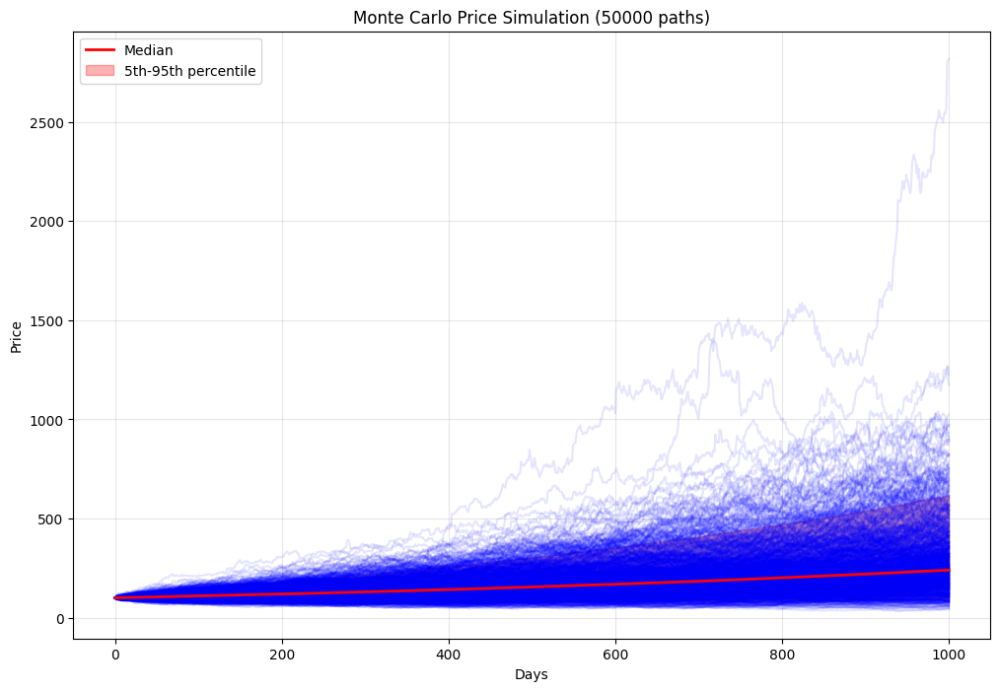

Comprehensive Simulation Statistics:
Mean Final Price: 283.1107
Median Final Price: 240.0741
Min Final Price: 20.8452
Max Final Price: 2818.1304
Standard Deviation: 177.9174
Variance: 31654.5926
5th Percentile: 92.4553
10th Percentile: 114.1678
25th Percentile: 162.4547
75th Percentile: 353.9100
90th Percentile: 501.6058
95th Percentile: 616.0369
Skewness: 2.1005
Kurtosis: 8.3223
Value at Risk (5%): 92.4553
Expected Shortfall (5%): 74.0369


{'Mean Final Price': np.float64(283.11069600706867),
 'Median Final Price': np.float64(240.07406595385987),
 'Min Final Price': np.float64(20.845173410720484),
 'Max Final Price': np.float64(2818.130353297321),
 'Standard Deviation': np.float64(177.9173757855241),
 'Variance': np.float64(31654.592606407394),
 '5th Percentile': np.float64(92.45529613632839),
 '10th Percentile': np.float64(114.16775325949187),
 '25th Percentile': np.float64(162.45473168042815),
 '75th Percentile': np.float64(353.9099908891954),
 '90th Percentile': np.float64(501.60582708046707),
 '95th Percentile': np.float64(616.0368993952274),
 'Skewness': np.float64(2.1005217366995117),
 'Kurtosis': np.float64(8.322295617569058),
 'Value at Risk (5%)': np.float64(92.45529613632839),
 'Expected Shortfall (5%)': np.float64(74.0369366471139)}

In [69]:
calculate_enhanced_statistics(simulated_paths)
plot_simulation_results(simulated_paths)

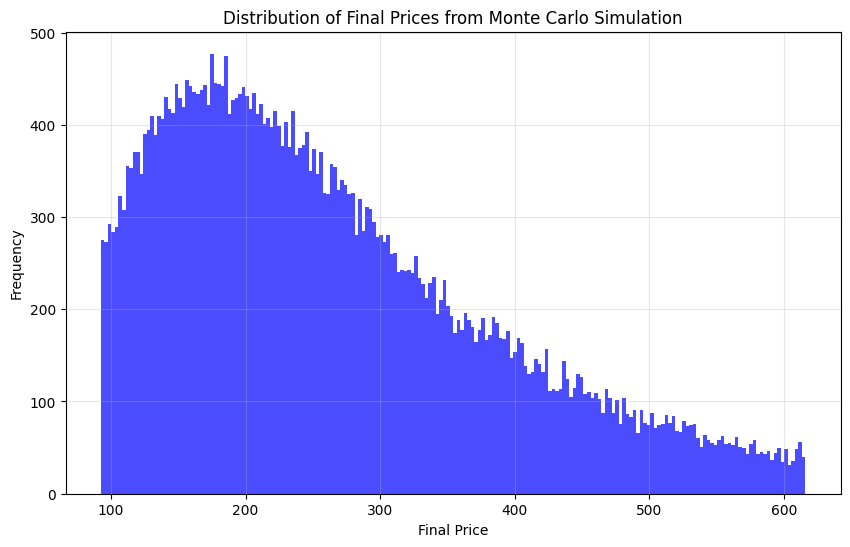

In [70]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'paths' is your simulation results array with shape (num_paths, num_days)
# Extract final prices from all simulation paths
final_prices = simulated_paths[:, -1]
percentile_5 = np.percentile(final_prices, 5)
percentile_95 = np.percentile(final_prices, 95)

# Filter final prices between the 5th and 95th percentiles (inclusive)
filtered_prices = final_prices[(final_prices >= percentile_5) & (final_prices <= percentile_95)]
# Plot the histogram of final prices
plt.figure(figsize=(10, 6))
plt.hist(filtered_prices, bins=200, color='blue', alpha=0.7)
plt.title('Distribution of Final Prices from Monte Carlo Simulation')
plt.xlabel('Final Price')
plt.ylabel('Frequency')
plt.grid(True, alpha=0.3)
plt.show()

In [73]:
import numpy as np

def calculate_sharpe_and_max_drawdown(paths, risk_free_rate=0.0):
    """Calculate Sharpe ratio and max drawdown for simulation paths."""
    # Calculate daily returns from price paths
    returns = np.diff(paths, axis=1) / paths[:, :-1]
    
    # Average daily return and std deviation on returns
    avg_daily_returns = np.mean(returns, axis=1)
    std_daily_returns = np.std(returns, axis=1)
    
    # Annualize assuming 252 trading days
    avg_annual_returns = avg_daily_returns * 252
    std_annual_returns = std_daily_returns * np.sqrt(252)
    
    # Sharpe ratio (annualized)
    sharpe_ratios = (avg_annual_returns - risk_free_rate) / std_annual_returns
    
    # Max drawdown calculation
    # Drawdown = (peak - current) / peak
    max_drawdowns = []
    for path in paths:
        peak = path[0]
        max_dd = 0
        for price in path:
            if price > peak:
                peak = price
            dd = (peak - price) / peak
            if dd > max_dd:
                max_dd = dd
        max_drawdowns.append(max_dd)
    
    return sharpe_ratios, max_drawdowns
ratio = calculate_sharpe_and_max_drawdown(simulated_paths)

In [79]:
sharpe_ratios, max_drawdowns = calculate_sharpe_and_max_drawdown(simulated_paths)

def summarize_metrics(sharpe_ratios, max_drawdowns):
    data = {
        "Sharpe Ratio": sharpe_ratios,
        "Max Drawdown": max_drawdowns
    }
    df = pd.DataFrame(data)
    print("Sharpe Ratio Summary:")
    print(df["Sharpe Ratio"].describe())
    print("\nMax Drawdown Summary:")
    print(df["Max Drawdown"].describe())

# After computing, call:
summarize_metrics(sharpe_ratios, max_drawdowns)

Sharpe Ratio Summary:
count    50000.000000
mean         0.901652
std          0.498950
min         -1.208574
25%          0.564804
50%          0.902405
75%          1.238737
max          2.952796
Name: Sharpe Ratio, dtype: float64

Max Drawdown Summary:
count    50000.000000
mean         0.351884
std          0.099997
min          0.122837
25%          0.278146
50%          0.336803
75%          0.410935
max          0.852998
Name: Max Drawdown, dtype: float64


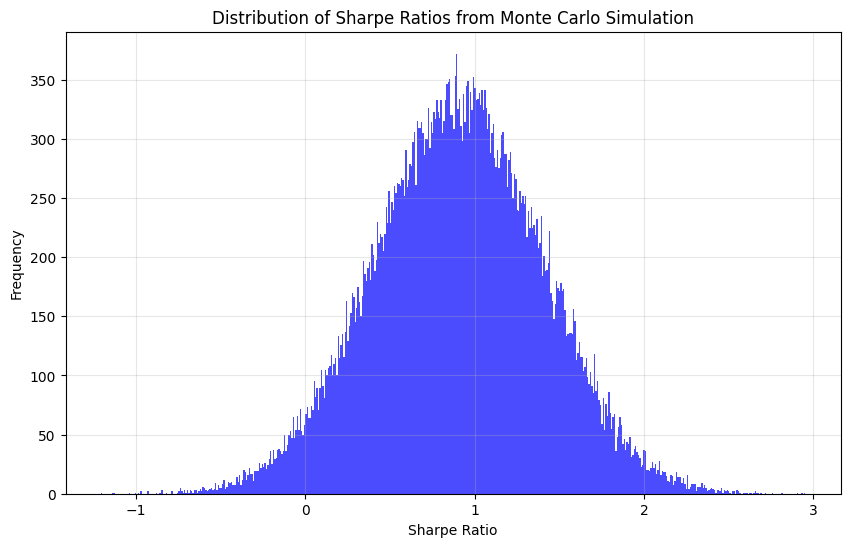

In [84]:
plt.figure(figsize=(10, 6))

# Plot the histogram of Sharpe ratios
plt.hist(sharpe_ratios, bins=500, color='blue', alpha=0.7)
plt.title('Distribution of Sharpe Ratios from Monte Carlo Simulation')
plt.xlabel('Sharpe Ratio')
plt.ylabel('Frequency')
plt.grid(True, alpha=0.3)
plt.show()